In [ ]:
from google.colab import files
#drive.mount('/content/gdrive')
import torch.nn as nn

In [ ]:

!pip install -q kaggle
uploaded = files.upload()
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!ls ~/.kaggle
!chmod 600 /root/.kaggle/kaggle.json
!kaggle datasets download -d bulentsiyah/semantic-drone-dataset
!unzip '/content/semantic-drone-dataset.zip'

Saving kaggle.json to kaggle.json
kaggle.json
100% 3.82G/3.83G [01:12<00:00, 72.2MB/s]
100% 3.83G/3.83G [01:13<00:00, 56.3MB/s]
Archive:  /content/semantic-drone-dataset.zip
  inflating: semantic_drone_dataset/label_images_semantic/000.png  
  inflating: semantic_drone_dataset/label_images_semantic/001.png  
  inflating: semantic_drone_dataset/label_images_semantic/002.png  
  inflating: semantic_drone_dataset/label_images_semantic/003.png  
  inflating: semantic_drone_dataset/label_images_semantic/004.png  
  inflating: semantic_drone_dataset/label_images_semantic/005.png  
  inflating: semantic_drone_dataset/label_images_semantic/006.png  
  inflating: semantic_drone_dataset/label_images_semantic/008.png  
  inflating: semantic_drone_dataset/label_images_semantic/011.png  
  inflating: semantic_drone_dataset/label_images_semantic/013.png  
  inflating: semantic_drone_dataset/label_images_semantic/014.png  
  inflating: semantic_drone_dataset/label_images_semantic/015.png  
  inflatin

In [ ]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import jaccard_score
from sklearn.model_selection import train_test_split

import numpy as np
import torch.nn.functional as F

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms as T
import torchvision
import torch.nn.functional as F
from torch.autograd import Variable

from PIL import Image
import cv2
import albumentations as A

import time
import os
from tqdm.notebook import tqdm

!pip install segmentation-models-pytorch
!pip install torchsummary
from torchsummary import summary
import segmentation_models_pytorch as smp

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

     |████████████████████████████████| 51kB 2.5MB/s 
     |████████████████████████████████| 61kB 4.8MB/s 
  Created wheel for pretrainedmodels: filename=pretrainedmodels-0.7.4-cp36-none-any.whl size=60964 sha256=d670278c32bb95be618375981c93c526339e85d457f98dee2d942f1f607efc18
  Stored in directory: /root/.cache/pip/wheels/69/df/63/62583c096289713f22db605aa2334de5b591d59861a02c2ecd
  Created wheel for efficientnet-pytorch: filename=efficientnet_pytorch-0.7.0-cp36-none-any.whl size=16031 sha256=0f4a5025a11d29098ad2d6006cacb31c2385ec61f9a8477bbf259580c49eaf98
  Stored in directory: /root/.cache/pip/wheels/e9/c6/e1/7a808b26406239712cfce4b5ceeb67d9513ae32aa4b31445c6
Successfully built pretrainedmodels efficientnet-pytorch


In [ ]:
IMAGE_PATH = '/content/semantic_drone_dataset/original_images/'
MASK_PATH = '/content/semantic_drone_dataset/label_images_semantic/'

In [ ]:
# https://github.com/said-rasidin/ML_Project/blob/master/Drone%20Segmentation/Drone_Segmentation.ipynb 

n_classes = 23 # labeling 종류가 23개임
# file id 읽기
name = []
for dirname, _, filenames in os.walk(IMAGE_PATH):
    for filename in filenames:
        name.append(filename.split('.')[0])

df = pd.DataFrame({'id': name}, index = np.arange(0, len(name)))
print('Number of Data: ', len(df))

# 데이터 split
X_trainval, X_test = train_test_split(df['id'].values, test_size=0.1, random_state=19)
X_train, X_val = train_test_split(X_trainval, test_size=0.15, random_state=19)

print('Train Size   : ', len(X_train))
print('Val Size     : ', len(X_val))
print('Test Size    : ', len(X_test))

Number of Data:  400
Train Size   :  306
Val Size     :  54
Test Size    :  40


Image Size (4000, 6000, 3)
Mask Size (4000, 6000)
Uniqe Pixel Value from mask [ 0  1  2  3  4  6  8  9 10 11 15 19 21 22]


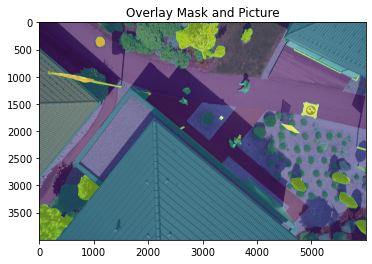

In [ ]:
img = Image.open(IMAGE_PATH + df['id'][1] + '.jpg')
mask = Image.open(MASK_PATH + df['id'][1] + '.png')
print('Image Size', np.asarray(img).shape)
print('Mask Size', np.asarray(mask).shape)
print('Uniqe Pixel Value from mask', np.unique(np.asarray(mask)))

plt.imshow(img)
plt.imshow(mask, alpha=0.6)
plt.title('Overlay Mask and Picture')
plt.show()

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
class Drone_data(Dataset):
    
    def __init__(self, img_path, mask_path, X, mean, std, transform=None, patch=False):
        self.img_path = img_path
        self.mask_path = mask_path
        self.X = X
        self.transform = transform
        self.patches = patch
        self.mean = mean
        self.std = std
        
    def __len__(self):
        return len(self.X)
    
    def __getitem__(self, idx):
    
        img = cv2.imread(self.img_path + self.X[idx] + '.jpg')
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        mask = cv2.imread(self.mask_path + self.X[idx] + '.png', cv2.IMREAD_GRAYSCALE)
        
        if self.transform is not None:
            aug = self.transform(image=img, mask=mask)
            img = Image.fromarray(aug['image'])
            mask = aug['mask']
        
        if self.transform is None:
            img = Image.fromarray(img)
      
        t = T.Compose([T.ToTensor(), T.Normalize(self.mean, self.std)])
        img = t(img)
        mask = torch.from_numpy(mask).long()
        
        if self.patches:
            img, mask = self.tiles(img, mask)
            
        return img, mask
    
    def tiles(self, img, mask):
        
        
        #for image
        img_patches = img.unfold(1, 512, 512).unfold(2, 768, 768) #tile overlap 50pixel
        img_patches  = img_patches.contiguous().view(3,-1, 512, 768) #change to total tile
        img_patches = img_patches.permute(1,0,2,3)#place the tiles number in the 0 index
        
        #for mask
        mask_patches = mask.unfold(0, 512, 512).unfold(1, 768, 768)
        mask_patches = mask_patches.contiguous().view(-1, 512, 768)
        
        return img_patches, mask_patches

In [ ]:
def calc_resize_ration(re_ration_to_depth=10, unet_depth=5, width=6000, height=4000):
    """
    calculation for image resize bacuause U-Net can only work if the size divisible by 2^depth
    example : depth 5, so the image divisible by (2^5) 8
    """
    width_to_height_rat = width/height
    unet_ratio = 2**unet_depth

    wid = unet_ratio * re_ration_to_depth * width_to_height_rat
    heig = unet_ratio * re_ration_to_depth 
    
    print('After resize with the same ration:')
    print(f' height:width = {heig, wid}')
    print(f' size after encoding can not be decimal: {heig/(2**unet_depth), wid/(2**unet_depth)}')

In [ ]:
calc_resize_ration(110)

After resize with the same ration:
 height:width = (3520, 5280.0)
 size after encoding can not be decimal: (110.0, 165.0)


In [ ]:
mean=[0.485, 0.456, 0.406]
std=[0.229, 0.224, 0.225]

t_train = A.Compose([A.Resize(704, 1056, interpolation=cv2.INTER_NEAREST), A.HorizontalFlip(), A.VerticalFlip(), 
                     A.GridDistortion(p=0.2), A.RandomBrightnessContrast((0,0.5),(0,0.5)),
                     A.GaussNoise()])

t_val = A.Compose([A.Resize(704, 1056, interpolation=cv2.INTER_NEAREST), A.HorizontalFlip(),
                   A.GridDistortion(p=0.2)])

#datasets
train_set = Drone_data(IMAGE_PATH, MASK_PATH, X_train, mean, std, t_train, patch=False)
val_set = Drone_data(IMAGE_PATH, MASK_PATH, X_val, mean, std, t_val, patch=False)

#dataloader
batch_size= 3 

train_loader = DataLoader(train_set, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_set, batch_size=batch_size, shuffle=True)

In [ ]:
model = smp.Unet('mobilenet_v2', encoder_weights='imagenet', classes=23, activation=None, encoder_depth=5, decoder_channels=[256, 128, 64, 32, 16])

Downloading: "https://download.pytorch.org/models/mobilenet_v2-b0353104.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v2-b0353104.pth


In [ ]:
def pixel_accuracy(output, mask):
    with torch.no_grad():
        output = torch.argmax(F.softmax(output, dim=1), dim=1)
        correct = torch.eq(output, mask).int()
        accuracy = float(correct.sum()) / float(correct.numel())
    return accuracy

def mIoU(pred_mask, mask, smooth=1e-10, n_classes=23):
    """
    calculate IoU perclass pixel
    input       : pre_mask = ouput from model as prediction mask
    mask        : ground truth mask
    smooth      : for non zero devision
    n_classes   : number of class label

    return : mean over all classes
    """
    with torch.no_grad():
        pred_mask = F.softmax(pred_mask, dim=1)
        pred_mask = torch.argmax(pred_mask, dim=1)
        pred_mask = pred_mask.contiguous().view(-1)
        mask = mask.contiguous().view(-1)

        iou_per_class = []
        for clas in range(0, n_classes): #loop per pixel class
            true_class = pred_mask == clas
            true_label = mask == clas

            if true_label.long().sum().item() == 0: #no exist label in this loop
                iou_per_class.append(np.nan)
            else:
                intersect = torch.logical_and(true_class, true_label).sum().float().item()
                union = torch.logical_or(true_class, true_label).sum().float().item()

                iou = (intersect + smooth) / (union +smooth)
                iou_per_class.append(iou)
        return np.nanmean(iou_per_class)




In [ ]:
#source :https://github.com/bermanmaxim/LovaszSoftmax/blob/master/pytorch/lovasz_losses.py

def lovasz_softmax(probas, labels, classes='present', per_image=False, ignore=None):
  if per_image:
        loss = mean(lovasz_softmax_flat(*flatten_probas(prob.unsqueeze(0), lab.unsqueeze(0), ignore), classes=classes)
                          for prob, lab in zip(probas, labels))
  else:
        loss = lovasz_softmax_flat(*flatten_probas(probas, labels, ignore), classes=classes)
  return loss

def lovasz_grad(gt_sorted):
    """
    Computes gradient of the Lovasz extension w.r.t sorted errors
    See Alg. 1 in paper
    """
    p = len(gt_sorted)
    gts = gt_sorted.sum()
    intersection = gts - gt_sorted.float().cumsum(0)
    union = gts + (1 - gt_sorted).float().cumsum(0)
    jaccard = 1. - intersection / union
    if p > 1: # cover 1-pixel case
        jaccard[1:p] = jaccard[1:p] - jaccard[0:-1]
    return jaccard

def lovasz_softmax_flat(probas, labels, classes='present'):
    """
    Multi-class Lovasz-Softmax loss
      probas: [P, C] Variable, class probabilities at each prediction (between 0 and 1)
      labels: [P] Tensor, ground truth labels (between 0 and C - 1)
      classes: 'all' for all, 'present' for classes present in labels, or a list of classes to average.
    """
    if probas.numel() == 0:
        # only void pixels, the gradients should be 0
        return probas * 0.
    C = probas.size(1)
    losses = []
    class_to_sum = list(range(C)) if classes in ['all', 'present'] else classes
    for c in class_to_sum:
        fg = (labels == c).float() # foreground for class c
        if (classes is 'present' and fg.sum() == 0):
            continue
        if C == 1:
            if len(classes) > 1:
                raise ValueError('Sigmoid output possible only with 1 class')
            class_pred = probas[:, 0]
        else:
            class_pred = probas[:, c]
        errors = (Variable(fg) - class_pred).abs()
        errors_sorted, perm = torch.sort(errors, 0, descending=True)
        perm = perm.data
        fg_sorted = fg[perm]
        losses.append(torch.dot(errors_sorted, Variable(lovasz_grad(fg_sorted))))
    return mean(losses)

def flatten_probas(probas, labels, ignore=None):
    """
    Flattens predictions in the batch
    """
    if probas.dim() == 3:
        # assumes output of a sigmoid layer
        B, H, W = probas.size()
        probas = probas.view(B, 1, H, W)
    B, C, H, W = probas.size()
    probas = probas.permute(0, 2, 3, 1).contiguous().view(-1, C)  # B * H * W, C = P, C
    labels = labels.view(-1)
    if ignore is None:
        return probas, labels
    valid = (labels != ignore)
    vprobas = probas[valid.nonzero().squeeze()]
    vlabels = labels[valid]
    return vprobas, vlabels

def xloss(logits, labels, ignore=None):
    """
    Cross entropy loss
    """
    return F.cross_entropy(logits, Variable(labels), ignore_index=255)

def isnan(x):
    return x != x

def mean(l, ignore_nan=False, empty=0):
    """
    nanmean compatible with generators.
    """
    l = iter(l)
    if ignore_nan:
        l = ifilterfalse(isnan, l)
    try:
        n = 1
        acc = next(l)
    except StopIteration:
        if empty == 'raise':
            raise ValueError('Empty mean')
        return empty
    for n, v in enumerate(l, 2):
        acc += v
    if n == 1:
        return acc
    return acc / n


In [ ]:
def get_lr(optimizer):
    for param_group in optimizer.param_groups:
        return param_group['lr']

def fit(epochs, model, train_loader, val_loader, criterion, optimizer, scheduler, patch=False):
  torch.cuda.empty_cache()
  train_losses = []
  test_losses = []
  val_iou = []; val_acc = []
  train_iou = []; train_acc = []
  lrs = []
  min_loss = np.inf
  decrease = 1 ; not_improve=0

  model.to(device)
  fit_time = time.time()
  for e in range(epochs):
        since = time.time()
        running_loss = 0
        iou_score = 0
        accuracy = 0
        #training loop
        model.train()
        for i, data in enumerate(tqdm(train_loader)):
            #training phase
            image_tiles, mask_tiles = data
            if patch:
                bs, n_tiles, c, h, w = image_tiles.size()

                image_tiles = image_tiles.view(-1,c, h, w)
                mask_tiles = mask_tiles.view(-1, h, w)
            image = image_tiles.to(device); mask = mask_tiles.to(device);
            #forward
            output = model(image)
            loss = criterion(output, mask)
            #evaluation metrics
            iou_score += mIoU(output, mask)
            accuracy += pixel_accuracy(output, mask)
            #backward
            loss.backward()
            optimizer.step() #update weight          
            optimizer.zero_grad() #reset gradient
            
            #step the learning rate
            lrs.append(get_lr(optimizer))
            scheduler.step() 
            
            running_loss += loss.item()
        else: 
            model.eval()
            test_loss = 0
            test_accuracy = 0
            val_iou_score = 0
            #validation loop
            with torch.no_grad():
                for i, data in enumerate(tqdm(val_loader)):
                    #reshape to 9 patches from single image, delete batch size
                    image_tiles, mask_tiles = data

                    if patch:
                        bs, n_tiles, c, h, w = image_tiles.size()

                        image_tiles = image_tiles.view(-1,c, h, w)
                        mask_tiles = mask_tiles.view(-1, h, w)
                    
                    image = image_tiles.to(device); mask = mask_tiles.to(device);
                    output = model(image)
                    #evaluation metrics
                    val_iou_score +=  mIoU(output, mask)
                    test_accuracy += pixel_accuracy(output, mask)
                    #loss
                    loss = criterion(output, mask)                                  
                    test_loss += loss.item()
            
            #calculatio mean for each batch
            train_losses.append(running_loss/len(train_loader))
            test_losses.append(test_loss/len(val_loader))


            if min_loss > (test_loss/len(val_loader)):
                print('Loss Decreasing.. {:.3f} >> {:.3f} '.format(min_loss, (test_loss/len(val_loader))))
                min_loss = (test_loss/len(val_loader))
                decrease += 1
                if decrease % 5 == 0:
                    print('saving model...')
                    torch.save(model, '/content/drive/My Drive/Colab Notebooks/models/Unet-Mobilenet_v2_mIoU-{:.3f}.pt'.format(val_iou_score/len(val_loader)))

            if (test_loss/len(val_loader)) > min_loss:
                not_improve += 1
                min_loss = (test_loss/len(val_loader))
                print(f'Loss Not Decrease for {not_improve} time')
                if not_improve == 7:
                    print('Loss not decrease for 7 times, Stop Training')
                    break
            val_iou.append(val_iou_score/len(val_loader))
            train_iou.append(iou_score/len(train_loader))
            train_acc.append(accuracy/len(train_loader))
            val_acc.append(test_accuracy/ len(val_loader))
            print("Epoch:{}/{}..".format(e+1, epochs),
                  "Train Loss: {:.3f}..".format(running_loss/len(train_loader)),
                  "Val Loss: {:.3f}..".format(test_loss/len(val_loader)),
                  "Train mIoU:{:.3f}..".format(iou_score/len(train_loader)),
                  "Val mIoU: {:.3f}..".format(val_iou_score/len(val_loader)),
                  "Train Acc:{:.3f}..".format(accuracy/len(train_loader)),
                  "Val Acc:{:.3f}..".format(test_accuracy/len(val_loader)),
                  "Time: {:.2f}m".format((time.time()-since)/60))
        
  history = {'train_loss' : train_losses, 'val_loss': test_losses,'train_miou' :train_iou, 'val_miou':val_iou,'train_acc' :train_acc, 'val_acc':val_acc,'lrs': lrs}
  print('Total time: {:.2f} m' .format((time.time()- fit_time)/60))
  return history


In [ ]:
max_lr = 1e-3 #1e-4
epoch = 30
weight_decay = 1e-4

criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=max_lr, weight_decay=weight_decay)
sched = torch.optim.lr_scheduler.OneCycleLR(optimizer, max_lr, epochs=epoch,
                                            steps_per_epoch=len(train_loader))

history = fit(epoch, model, train_loader, val_loader, criterion, optimizer, sched)


Loss Decreasing.. inf >> 1.914 
Epoch:1/30.. Train Loss: 2.665.. Val Loss: 1.914.. Train mIoU:0.066.. Val mIoU: 0.113.. Train Acc:0.319.. Val Acc:0.606.. Time: 4.41m



Loss Decreasing.. 1.914 >> 1.529 
Epoch:2/30.. Train Loss: 2.008.. Val Loss: 1.529.. Train mIoU:0.107.. Val mIoU: 0.123.. Train Acc:0.562.. Val Acc:0.657.. Time: 4.40m



Loss Decreasing.. 1.529 >> 1.113 
Epoch:3/30.. Train Loss: 1.615.. Val Loss: 1.113.. Train mIoU:0.128.. Val mIoU: 0.161.. Train Acc:0.621.. Val Acc:0.707.. Time: 4.37m



Loss Decreasing.. 1.113 >> 0.954 
saving model...
Epoch:4/30.. Train Loss: 1.325.. Val Loss: 0.954.. Train mIoU:0.158.. Val mIoU: 0.187.. Train Acc:0.662.. Val Acc:0.741.. Time: 4.39m



Loss Not Decrease for 1 time
Epoch:5/30.. Train Loss: 1.269.. Val Loss: 0.989.. Train mIoU:0.160.. Val mIoU: 0.179.. Train Acc:0.645.. Val Acc:0.727.. Time: 4.35m



Loss Decreasing.. 0.989 >> 0.920 
Epoch:6/30.. Train Loss: 1.124.. Val Loss: 0.920.. Train mIoU:0.182.. Val mIoU: 0.196.. Train Acc:0.684.. Val Acc:0.743.. Time: 4.36m



Loss Decreasing.. 0.920 >> 0.818 
Epoch:7/30.. Train Loss: 1.106.. Val Loss: 0.818.. Train mIoU:0.199.. Val mIoU: 0.244.. Train Acc:0.682.. Val Acc:0.767.. Time: 4.33m



Loss Not Decrease for 2 time
Epoch:8/30.. Train Loss: 1.087.. Val Loss: 0.819.. Train mIoU:0.203.. Val mIoU: 0.244.. Train Acc:0.680.. Val Acc:0.769.. Time: 4.31m



Loss Not Decrease for 3 time
Epoch:9/30.. Train Loss: 1.064.. Val Loss: 0.876.. Train mIoU:0.204.. Val mIoU: 0.217.. Train Acc:0.684.. Val Acc:0.745.. Time: 4.33m



Loss Decreasing.. 0.876 >> 0.704 
Epoch:10/30.. Train Loss: 0.966.. Val Loss: 0.704.. Train mIoU:0.221.. Val mIoU: 0.245.. Train Acc:0.717.. Val Acc:0.786.. Time: 4.34m



Loss Not Decrease for 4 time
Epoch:11/30.. Train Loss: 0.926.. Val Loss: 0.807.. Train mIoU:0.230.. Val mIoU: 0.241.. Train Acc:0.721.. Val Acc:0.771.. Time: 4.22m



Loss Decreasing.. 0.807 >> 0.676 
Epoch:12/30.. Train Loss: 0.880.. Val Loss: 0.676.. Train mIoU:0.240.. Val mIoU: 0.261.. Train Acc:0.741.. Val Acc:0.795.. Time: 4.19m



Loss Not Decrease for 5 time
Epoch:13/30.. Train Loss: 0.850.. Val Loss: 0.730.. Train mIoU:0.250.. Val mIoU: 0.280.. Train Acc:0.745.. Val Acc:0.791.. Time: 4.23m



Loss Decreasing.. 0.730 >> 0.652 
saving model...
Epoch:14/30.. Train Loss: 0.833.. Val Loss: 0.652.. Train mIoU:0.261.. Val mIoU: 0.275.. Train Acc:0.758.. Val Acc:0.810.. Time: 4.21m



Loss Not Decrease for 6 time
Epoch:15/30.. Train Loss: 0.761.. Val Loss: 0.849.. Train mIoU:0.283.. Val mIoU: 0.250.. Train Acc:0.772.. Val Acc:0.770.. Time: 4.22m



Loss Decreasing.. 0.849 >> 0.600 
Epoch:16/30.. Train Loss: 0.763.. Val Loss: 0.600.. Train mIoU:0.288.. Val mIoU: 0.308.. Train Acc:0.772.. Val Acc:0.820.. Time: 4.24m



Loss Decreasing.. 0.600 >> 0.537 
Epoch:17/30.. Train Loss: 0.680.. Val Loss: 0.537.. Train mIoU:0.305.. Val mIoU: 0.324.. Train Acc:0.797.. Val Acc:0.839.. Time: 4.23m



Loss Not Decrease for 7 time
Loss not decrease for 7 times, Stop Training
Total time: 77.36 m


In [ ]:
def fit(epochs, model, train_loader, val_loader, criterion, optimizer, scheduler, a=0.7):
    torch.cuda.empty_cache()
    train_losses = []
    test_losses = []
    val_iou = []; val_acc = []
    train_iou = []; train_acc = []
    lrs = []
    min_loss = np.inf
    decrease = 1 ; not_improve=0

    model.to(device)
    fit_time = time.time()
    for e in range(epochs):
        since = time.time()
        running_loss = 0
        iou_score = 0
        accuracy = 0
        #training loop
        model.train()
        for i, data in enumerate(tqdm(train_loader)):
            #training phase
            image_tiles, mask_tiles = data
            image = image_tiles.to(device); mask = mask_tiles.to(device);
            #forward
            output = model(image)
            output1 = F.softmax(output, dim=1)
            #loss
            loss1 = criterion(output, mask)
            loss2 = lovasz_softmax(output1, mask)
            loss = ((1-a)*loss1) + (a * loss2)
            #evaluation metrics
            iou_score += mIoU(output, mask)
            accuracy += pixel_accuracy(output, mask)
            #backward
            loss.backward()
            optimizer.step() #update weight          
            optimizer.zero_grad() #reset gradient

            scheduler.step() 
            running_loss += loss.item()
           
        else:
            model.eval()
            test_loss = 0
            test_accuracy = 0
            val_iou_score = 0
            #validation loop
            with torch.no_grad():
                for i, data in enumerate(tqdm(val_loader)):
                    image_tiles, mask_tiles = data                  
                    image = image_tiles.to(device); mask = mask_tiles.to(device)
                    #forward
                    output = model(image)
                    output1 = F.softmax(output, dim=1)
                    #loss
                    loss1 = criterion(output, mask)
                    loss2 = lovasz_softmax(output1, mask)
                    loss = ((1-a)*loss1) + (a * loss2)
                    #evaluation metrics
                    val_iou_score +=  mIoU(output, mask)
                    test_accuracy += pixel_accuracy(output, mask)
                    #loss                         
                    test_loss += loss.item()
            
            #calculatio mean for each batch
            train_losses.append(running_loss/len(train_loader))
            test_losses.append(test_loss/len(val_loader))

            if min_loss > (test_loss/len(val_loader)):
                print('Loss Decreasing.. {:.3f} >> {:.3f} '.format(min_loss, (test_loss/len(val_loader))))
                min_loss = (test_loss/len(val_loader))
                decrease += 1
                if decrease % 5 == 0:
                    print('saving model...')
                    torch.save(model, '/content/drive/My Drive/Colab Notebooks/models/Unet-Mobilenet_v2(lovasz)_mIoU{:.3f}.pt'.format(val_iou_score/len(val_loader)))

            if (test_loss/len(val_loader)) > min_loss:
                not_improve += 1
                min_loss = (test_loss/len(val_loader))
                print(f'Loss Not Decrease for {not_improve} time')
                if not_improve == 7:
                    print('Loss not decrease for 7 times, Stop Training')
                    break
                 
            val_iou.append(val_iou_score/len(val_loader))
            train_iou.append(iou_score/len(train_loader))
            train_acc.append(accuracy/len(train_loader))
            val_acc.append(test_accuracy/ len(val_loader))
            print("Epoch:{}/{}..".format(e+1, epochs),
                  "Train Loss: {:.3f}..".format(running_loss/len(train_loader)),
                  "Val Loss: {:.3f}..".format(test_loss/len(val_loader)),
                  "Train mIoU:{:.3f}..".format(iou_score/len(train_loader)),
                  "Val mIoU: {:.3f}..".format(val_iou_score/len(val_loader)),
                  "Train Acc:{:.3f}..".format(accuracy/len(train_loader)),
                  "Val Acc:{:.3f}..".format(test_accuracy/len(val_loader)),
                  "Time: {:.2f}m".format((time.time()-since)/60))
        
    history = {'train_loss' : train_losses, 'val_loss': test_losses,
               'train_miou' :train_iou, 'val_miou':val_iou,
               'train_acc' :train_acc, 'val_acc':val_acc,
               'lrs': lrs}
    print('Total time: {:.2f} m' .format((time.time()- fit_time)/60))
    return history


In [ ]:
epoch = 20
max_lr = 1e-4
weight_decay = 1e-4

criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=max_lr, weight_decay=weight_decay)
sched = torch.optim.lr_scheduler.OneCycleLR(optimizer, max_lr, epochs=epoch,
                                            steps_per_epoch=len(train_loader))

history_lovasz = fit(epoch, model, train_loader, val_loader, criterion, optimizer, scheduler=sched)


Loss Decreasing.. inf >> 0.611 
Epoch:1/20.. Train Loss: 0.650.. Val Loss: 0.611.. Train mIoU:0.338.. Val mIoU: 0.350.. Train Acc:0.810.. Val Acc:0.835.. Time: 4.93m



Loss Decreasing.. 0.611 >> 0.592 
Epoch:2/20.. Train Loss: 0.641.. Val Loss: 0.592.. Train mIoU:0.348.. Val mIoU: 0.376.. Train Acc:0.817.. Val Acc:0.843.. Time: 4.89m



Loss Decreasing.. 0.592 >> 0.586 
Epoch:3/20.. Train Loss: 0.624.. Val Loss: 0.586.. Train mIoU:0.366.. Val mIoU: 0.388.. Train Acc:0.825.. Val Acc:0.847.. Time: 4.99m



Loss Decreasing.. 0.586 >> 0.569 
saving model...
Epoch:4/20.. Train Loss: 0.605.. Val Loss: 0.569.. Train mIoU:0.388.. Val mIoU: 0.393.. Train Acc:0.832.. Val Acc:0.846.. Time: 5.06m



Loss Decreasing.. 0.569 >> 0.564 
Epoch:5/20.. Train Loss: 0.602.. Val Loss: 0.564.. Train mIoU:0.388.. Val mIoU: 0.407.. Train Acc:0.828.. Val Acc:0.850.. Time: 4.93m



Loss Decreasing.. 0.564 >> 0.559 
Epoch:6/20.. Train Loss: 0.584.. Val Loss: 0.559.. Train mIoU:0.412.. Val mIoU: 0.412.. Train Acc:0.835.. Val Acc:0.851.. Time: 4.91m



Loss Decreasing.. 0.559 >> 0.550 
Epoch:7/20.. Train Loss: 0.579.. Val Loss: 0.550.. Train mIoU:0.418.. Val mIoU: 0.421.. Train Acc:0.838.. Val Acc:0.862.. Time: 4.92m



Loss Decreasing.. 0.550 >> 0.528 
Epoch:8/20.. Train Loss: 0.563.. Val Loss: 0.528.. Train mIoU:0.427.. Val mIoU: 0.442.. Train Acc:0.843.. Val Acc:0.870.. Time: 4.89m



Loss Decreasing.. 0.528 >> 0.517 
saving model...
Epoch:9/20.. Train Loss: 0.550.. Val Loss: 0.517.. Train mIoU:0.441.. Val mIoU: 0.459.. Train Acc:0.849.. Val Acc:0.871.. Time: 4.90m



Loss Decreasing.. 0.517 >> 0.513 
Epoch:10/20.. Train Loss: 0.541.. Val Loss: 0.513.. Train mIoU:0.450.. Val mIoU: 0.459.. Train Acc:0.853.. Val Acc:0.871.. Time: 4.91m



Loss Not Decrease for 1 time
Epoch:11/20.. Train Loss: 0.530.. Val Loss: 0.514.. Train mIoU:0.459.. Val mIoU: 0.455.. Train Acc:0.856.. Val Acc:0.871.. Time: 4.89m



Loss Not Decrease for 2 time
Epoch:12/20.. Train Loss: 0.531.. Val Loss: 0.515.. Train mIoU:0.462.. Val mIoU: 0.459.. Train Acc:0.856.. Val Acc:0.869.. Time: 4.89m



Loss Decreasing.. 0.515 >> 0.491 
Epoch:13/20.. Train Loss: 0.512.. Val Loss: 0.491.. Train mIoU:0.482.. Val mIoU: 0.489.. Train Acc:0.862.. Val Acc:0.877.. Time: 4.91m



Loss Not Decrease for 3 time
Epoch:14/20.. Train Loss: 0.513.. Val Loss: 0.498.. Train mIoU:0.481.. Val mIoU: 0.481.. Train Acc:0.864.. Val Acc:0.877.. Time: 4.90m



Loss Not Decrease for 4 time
Epoch:15/20.. Train Loss: 0.513.. Val Loss: 0.498.. Train mIoU:0.478.. Val mIoU: 0.481.. Train Acc:0.861.. Val Acc:0.874.. Time: 4.88m



Loss Decreasing.. 0.498 >> 0.489 
Epoch:16/20.. Train Loss: 0.492.. Val Loss: 0.489.. Train mIoU:0.501.. Val mIoU: 0.487.. Train Acc:0.870.. Val Acc:0.880.. Time: 4.94m



Loss Decreasing.. 0.489 >> 0.483 
Epoch:17/20.. Train Loss: 0.495.. Val Loss: 0.483.. Train mIoU:0.495.. Val mIoU: 0.499.. Train Acc:0.870.. Val Acc:0.878.. Time: 4.97m



Loss Decreasing.. 0.483 >> 0.472 
saving model...
Epoch:18/20.. Train Loss: 0.494.. Val Loss: 0.472.. Train mIoU:0.498.. Val mIoU: 0.517.. Train Acc:0.869.. Val Acc:0.879.. Time: 4.93m



Loss Not Decrease for 5 time
Epoch:19/20.. Train Loss: 0.491.. Val Loss: 0.488.. Train mIoU:0.500.. Val mIoU: 0.489.. Train Acc:0.871.. Val Acc:0.879.. Time: 4.93m



Loss Decreasing.. 0.488 >> 0.481 
Epoch:20/20.. Train Loss: 0.488.. Val Loss: 0.481.. Train mIoU:0.503.. Val mIoU: 0.496.. Train Acc:0.872.. Val Acc:0.878.. Time: 5.03m
Total time: 98.59 m


In [ ]:
def plot_loss(history):
    plt.plot(history['val_loss'], label='val', marker='o')
    plt.plot( history['train_loss'], label='train', marker='o')
    plt.title('Loss per epoch'); plt.ylabel('loss');
    plt.xlabel('epoch')
    plt.legend(), plt.grid()
    plt.show()
    
def plot_score(history):
    plt.plot(history['train_miou'], label='train_mIoU', marker='*')
    plt.plot(history['val_miou'], label='val_mIoU',  marker='*')
    plt.title('Score per epoch'); plt.ylabel('mean IoU')
    plt.xlabel('epoch')
    plt.legend(), plt.grid()
    plt.show()

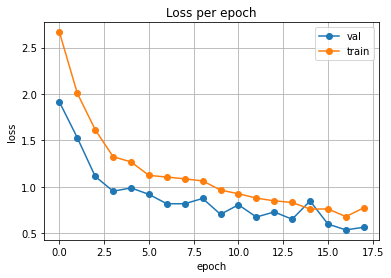

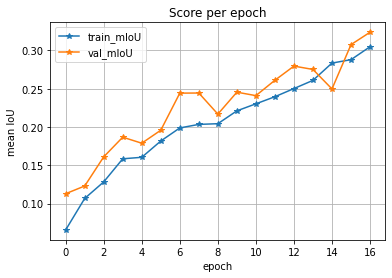

In [ ]:
plot_loss(history)
plot_score(history)

In [ ]:
torch.save(model, '/content/drive/My Drive/Colab Notebooks/models/Unet-Mobilenet_v2-lovasz_0.554.pt')

In [ ]:
model_Unet = torch.load('/content/drive/My Drive/Colab Notebooks/models/Unet-Mobilenet_v2-lovasz_0.554.pt')

In [ ]:

class Drone_Test_Data(Dataset):    
    def __init__(self, img_path, mask_path, X, transform=None):
        self.img_path = img_path
        self.mask_path = mask_path
        self.X = X
        self.transform = transform
      
    def __len__(self):
        return len(self.X)
    
    def __getitem__(self, idx):
        """
        get item per index
        """
        img = cv2.imread(self.img_path + self.X[idx] + '.jpg')
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        mask = cv2.imread(self.mask_path + self.X[idx] + '.png', cv2.IMREAD_GRAYSCALE)
        
        if self.transform is not None:
            aug = self.transform(image=img, mask=mask)
            img = Image.fromarray(aug['image'])
            mask = aug['mask']
        
        if self.transform is None:
            img = Image.fromarray(img)
        
        mask = torch.from_numpy(mask).long()
        
        return img, mask


In [ ]:
t_test = A.Resize(768, 1152, interpolation=cv2.INTER_NEAREST)

test_set = Drone_Test_Data(IMAGE_PATH, MASK_PATH, X_test, transform=t_test)

In [ ]:
def predict_image_mask(model, image, mask, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):
    model.eval()
    t = T.Compose([T.ToTensor(), T.Normalize(mean, std)])
    image = t(image)
    model.to(device); image=image.to(device)
    mask = mask.to(device)
    with torch.no_grad():
        
        image = image.unsqueeze(0)
        mask = mask.unsqueeze(0)
        
        output = model(image)
        score = mIoU(output, mask)
        masked = torch.argmax(output, dim=1)
        masked = masked.cpu().squeeze(0)
    return masked, score

In [ ]:
image, mask = test_set[11]

In [ ]:
pred_mask, score = predict_image_mask(model_Unet, image, mask)

In [ ]:
def predict_image_mask(model, image, mask, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):
    model.eval()
    t = T.Compose([T.ToTensor(), T.Normalize(mean, std)])
    image = t(image)
    model.to(device); image=image.to(device)
    mask = mask.to(device)
    with torch.no_grad():
        
        image = image.unsqueeze(0)
        mask = mask.unsqueeze(0)
        
        output = model(image)
        acc = pixel_accuracy(output, mask)
        masked = torch.argmax(output, dim=1)
        masked = masked.cpu().squeeze(0)
    return masked, acc

In [ ]:
def score_all_set(model, test_set):
    accuracy = []
    for i in tqdm(range(len(test_set))):
        img, mask = test_set[i]
        pred_mask, acc = predict_image_mask(model, img, mask)
        accuracy.append(acc)
    return accuracy

In [ ]:
pixel_accuracy = score_all_set(model_Unet,test_set)

In [ ]:
print('Pixel Accuracy',pixel_accuracy)

Pixel Accuracy [0.8422885470920138, 0.7547788266782407, 0.9067416720920138, 0.9223395453559028, 0.9528639051649306, 0.7978018301504629, 0.9131684479890047, 0.9131085431134259, 0.9066026475694444, 0.927490234375, 0.9083523220486112, 0.9469446252893519, 0.9618112069589121, 0.9461376048900463, 0.9132769549334491, 0.8314785427517362, 0.9583943684895834, 0.8694096317997685, 0.7746118616174769, 0.8909166124131944, 0.9761906376591435, 0.9410524721498843, 0.9933935094762731, 0.8989890769675926, 0.7893495912905093, 0.8591805917245371, 0.90765380859375, 0.9743833188657407, 0.8899965639467593, 0.9168147334346065, 0.9355095757378472, 0.9098262080439815, 0.8675559714988426, 0.817108154296875, 0.9735039605034722, 0.9360464590567129, 0.9280938042534722, 0.7955209237557871, 0.8301764594184028, 0.9732812952112269]


In [ ]:
def predict_image_time(model, image, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):
    since = time.time()
    model.eval()
    t = T.Compose([T.ToTensor(), T.Normalize(mean, std)])
    image = t(image)
    model.to(device); image=image.to(device)
    with torch.no_grad():
        
        image = image.unsqueeze(0)
        
        output = model(image)
        masked = torch.argmax(output, dim=1)
    return masked, time.time()-since

In [ ]:
def inference_time(test_set, model):
    waktu = []
    for i in tqdm(range(len(test_set))):
        img, _ = test_set[i]
        _, times = predict_image_time(model, img)
        waktu.append(times)
    return waktu

In [ ]:
print("Time : ",np.mean(inference_time(test_set,model_Unet)))


Time :  0.03306353688240051


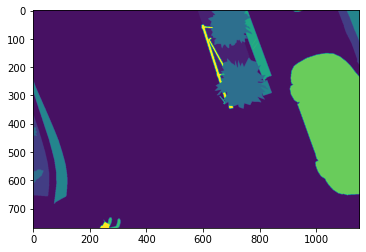

In [ ]:

plt.imshow(mask)

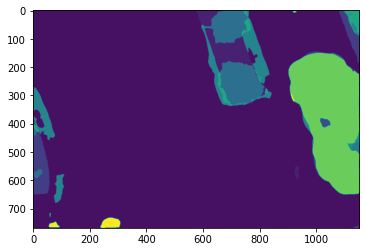

In [ ]:
plt.imshow(pred_mask)

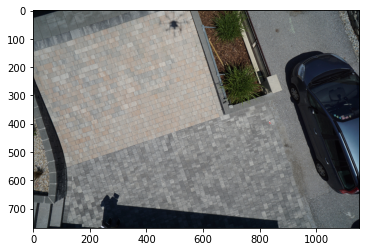

In [ ]:
plt.imshow(image)

In [ ]:
files.upload()

Saving orthogonal-imagery-1.jpg to orthogonal-imagery-1.jpg


{'orthogonal-imagery-1.jpg': b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00\x01\x00\x01\x00\x00\xff\xdb\x00\x84\x00\x03\x03\x03\x03\x03\x03\x04\x04\x04\x04\x05\x05\x05\x05\x05\x07\x07\x06\x06\x07\x07\x0b\x08\t\x08\t\x08\x0b\x11\x0b\x0c\x0b\x0b\x0c\x0b\x11\x0f\x12\x0f\x0e\x0f\x12\x0f\x1b\x15\x13\x13\x15\x1b\x1f\x1a\x19\x1a\x1f&""&0-0>>T\x01\x03\x03\x03\x03\x03\x03\x04\x04\x04\x04\x05\x05\x05\x05\x05\x07\x07\x06\x06\x07\x07\x0b\x08\t\x08\t\x08\x0b\x11\x0b\x0c\x0b\x0b\x0c\x0b\x11\x0f\x12\x0f\x0e\x0f\x12\x0f\x1b\x15\x13\x13\x15\x1b\x1f\x1a\x19\x1a\x1f&""&0-0>>T\xff\xc2\x00\x11\x08\x03 \x04\xb0\x03\x01"\x00\x02\x11\x01\x03\x11\x01\xff\xc4\x00\x1d\x00\x00\x02\x02\x03\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x05\x06\x04\x07\x02\x03\x08\x01\x00\t\xff\xda\x00\x08\x01\x01\x00\x00\x00\x00\xd7\xd0\xdc\x9c\xbd\x81=n\x80\xf0\x15\xa27L\x96\xe3\xf07\xdb\xd6\xfak\n:\xcc\xbb\xc4T\x05\x9e\x9f>\xad\xf9\xa2\xb4\x06\xda:\xb4\xb54HhL)\xd3|\xf4\xd5gm\xd9\xd1\xcb<sy\xbaR\xba\x8b\x15\x13/D\x9d\x11\xf

In [ ]:
!unzip '/content/CansatMap.zip'

Archive:  /content/CansatMap.zip
  inflating: MAP_ACENTER.jpg         
  inflating: MAP_ACENTER_S.jpg       
  inflating: MAP_KAIST.jpg           
  inflating: MAP_KAIST_S.JPG         


In [ ]:
img1 = Image.open('MAP_ACENTER_S.jpg')
img2 = Image.open('MAP_KAIST_S.JPG')
img3 = Image.open('MAP_ACENTER.jpg')
img4 = Image.open('MAP_KAIST.jpg')

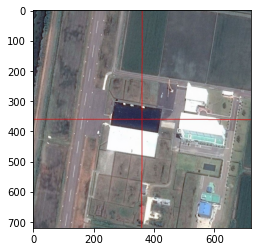

In [ ]:
plt.imshow(img1)


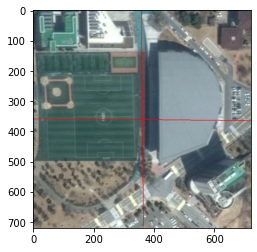

In [ ]:
plt.imshow(img2)

In [ ]:
resize_image1 = img1.resize((1152,768))
resize_image2 = img2.resize((1152,768))
resize_image3 = img3.resize((1152,768))
resize_image4 = img4.resize((1152,768))

In [ ]:
resize_image1.save('/content/MAP_ACENTER_S1.jpg')
resize_image2.save('/content/MAP_KAIST_S1.jpg')
resize_image3.save('/content/MAP_ACENTER1.jpg')
resize_image4.save('/content/MAP_KAIST1.jpg')

In [ ]:
img1 = Image.open('MAP_ACENTER_S1.jpg')
img2 = Image.open('MAP_KAIST_S1.jpg')
img3 = Image.open('MAP_ACENTER1.jpg')
img4 = Image.open('MAP_KAIST1.jpg')

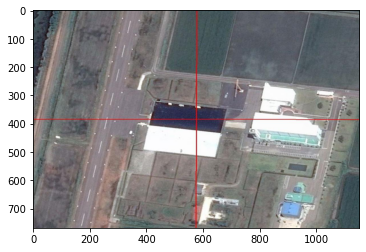

In [ ]:
plt.imshow(img1)

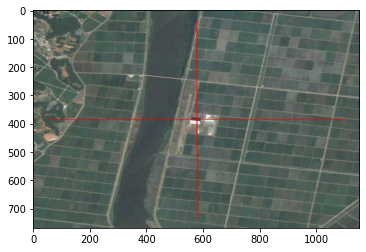

In [ ]:
plt.imshow(img3)

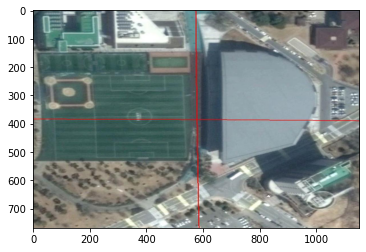

In [ ]:
plt.imshow(img2)

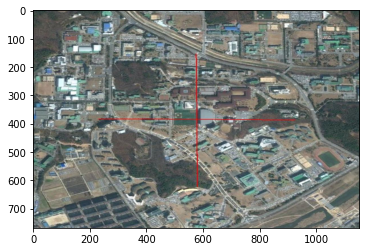

In [ ]:
plt.imshow(img4)

In [ ]:
def predict_image_mask(model, image, mask, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):
    model.eval()
    t = T.Compose([T.ToTensor(), T.Normalize(mean, std)])
    image = t(image)
    model.to(device); image=image.to(device)
    mask = mask.to(device)
    with torch.no_grad():
        
        image = image.unsqueeze(0)
        mask = mask.unsqueeze(0)
        
        output = model(image)
        score = mIoU(output, mask)
        masked = torch.argmax(output, dim=1)
        masked = masked.cpu().squeeze(0)
    return masked, score

In [ ]:
pred_mask1,score1= predict_image_mask(model_Unet, img1, mask)
pred_mask2,score2= predict_image_mask(model_Unet,img2,mask)
pred_mask3,score3= predict_image_mask(model_Unet,img3,mask)
pred_mask4,score4 = predict_image_mask(model_Unet,img4,mask)

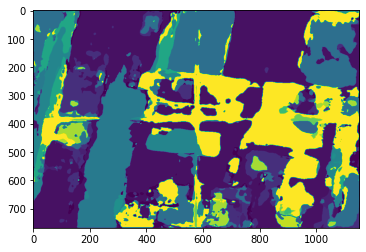

In [ ]:
plt.imshow(pred_mask1)

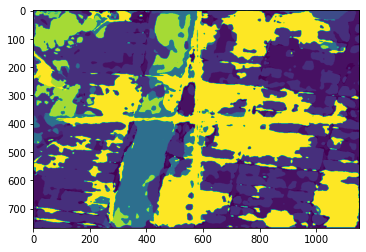

In [ ]:
plt.imshow(pred_mask3)

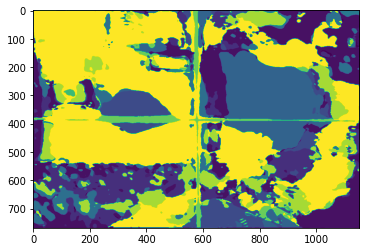

In [ ]:
plt.imshow(pred_mask2)

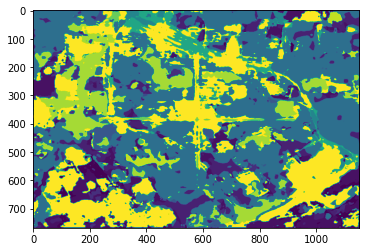

In [ ]:
plt.imshow(pred_mask4)

In [ ]:
files.upload()

Saving Picture_200805_141335.jpg to Picture_200805_141335.jpg
Saving Picture_200805_141338.jpg to Picture_200805_141338.jpg
Saving Picture_200805_141341.jpg to Picture_200805_141341.jpg
Saving Picture_200805_141354.jpg to Picture_200805_141354.jpg
Saving Picture_200805_141357.jpg to Picture_200805_141357.jpg
Saving Picture_200805_141402.jpg to Picture_200805_141402.jpg
Saving Picture_200805_141406.jpg to Picture_200805_141406.jpg
Saving Picture_200805_141412.jpg to Picture_200805_141412.jpg
Saving Picture_200805_141415.jpg to Picture_200805_141415.jpg
Saving Picture_200805_141418.jpg to Picture_200805_141418.jpg
Saving Picture_200805_141422.jpg to Picture_200805_141422.jpg
Saving Picture_200805_141433.jpg to Picture_200805_141433.jpg
Saving Picture_200805_141448.jpg to Picture_200805_141448.jpg
Saving Picture_200805_141451.jpg to Picture_200805_141451.jpg
Saving Picture_200805_141454.jpg to Picture_200805_141454.jpg
Saving Picture_200805_141458.jpg to Picture_200805_141458.jpg
Saving P

{'Picture_200805_141335.jpg': b'\xff\xd8\xff\xfe\x00$\x19:\xcfb\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\xf0\x00@\x01\x07\x002\x12\x0bQ\x04Q\x04\x00\x00\xff\xdb\x00\x84\x00\x02\x01\x01\x02\x01\x01\x02\x02\x01\x02\x02\x02\x02\x02\x03\x04\x03\x03\x02\x02\x03\x05\x04\x04\x03\x04\x06\x06\x07\x07\x06\x06\x06\x06\x07\x08\n\t\x07\x07\n\x08\x06\x06\t\x0c\t\n\n\x0b\x0b\x0b\x0b\x07\x08\x0c\r\x0c\x0b\r\n\x0b\x0b\x0b\x01\x02\x02\x02\x03\x02\x03\x05\x03\x03\x05\x0b\x07\x06\x07\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\x0b\xff\xfe\x00\x05\x00\x00\x00\xff\xc0\x00\x11\x08\x00\xf0\x01@\x03\x01!\x00\x02\x11\x01\x03\x11\x01\xff\xc4\x01\xa2\x00\x00\x01\x05\x01\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x01\x02\x03\x04\x05\x06\x07\x08\t\n\x0b\x01\x00\x03\x01\x01\x01\x01\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x01\x02\x03\x0

In [ ]:
import matplotlib.pyplot as plt

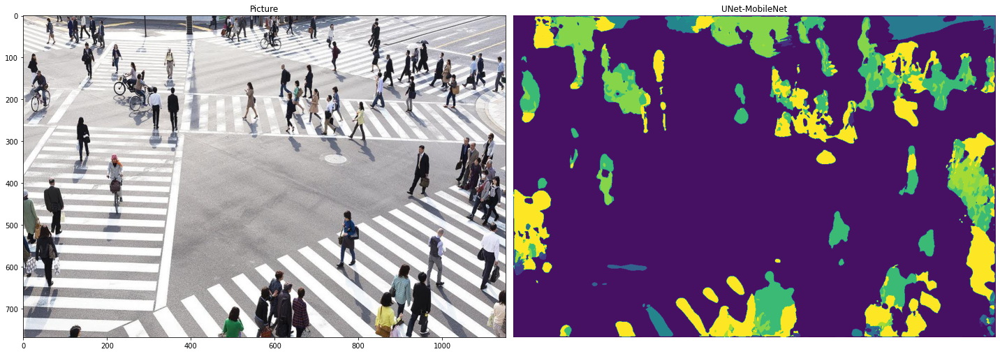

In [ ]:
img = Image.open('/content/maxresdefault (1).jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


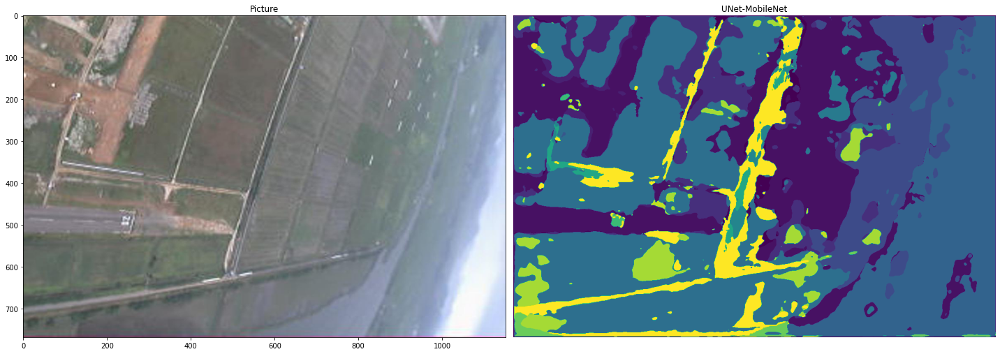

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '357'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


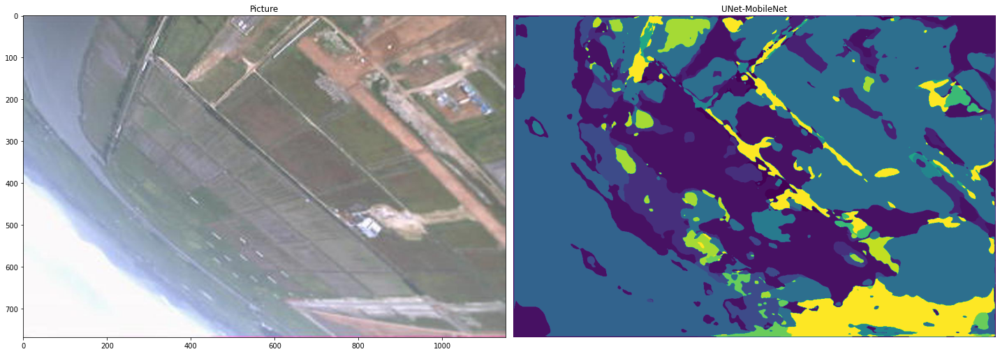

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '402'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


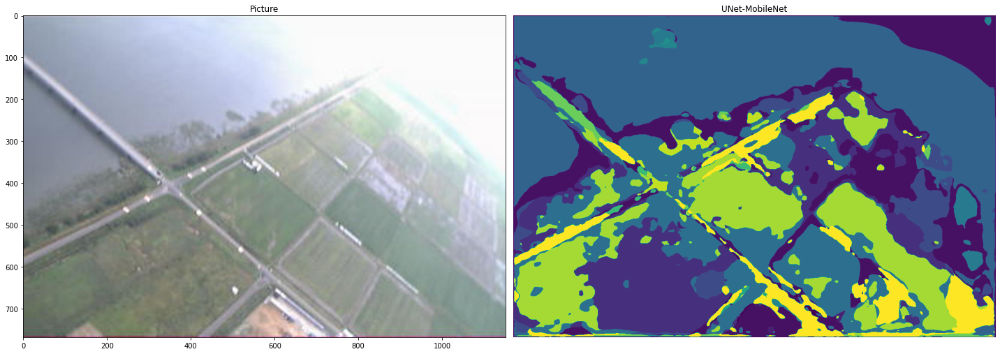

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '406'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


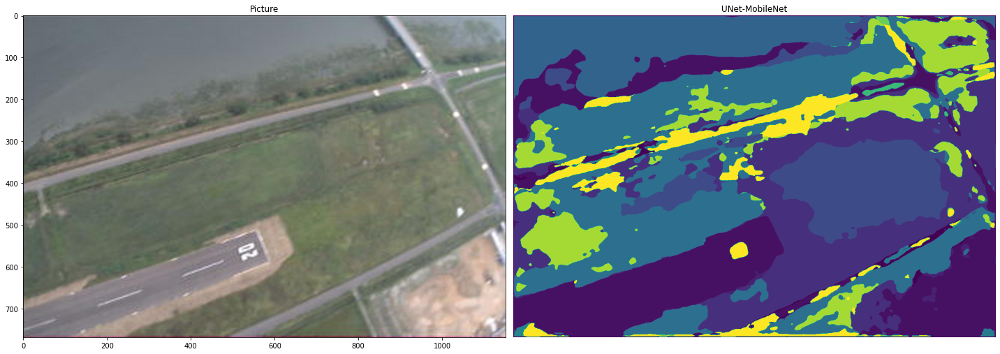

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '412'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


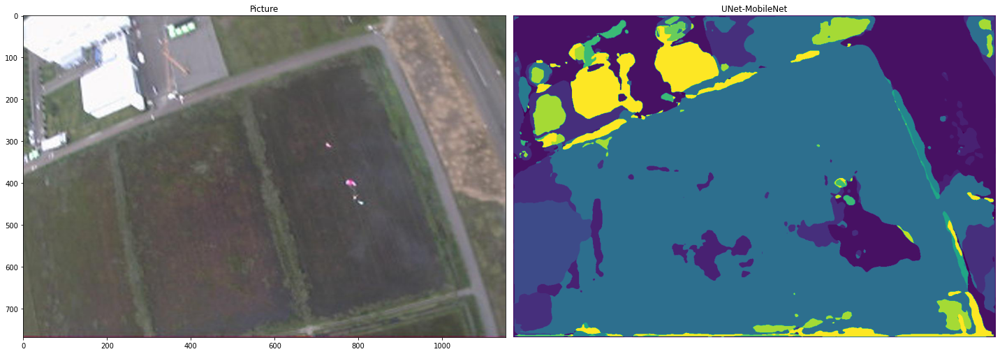

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '415'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


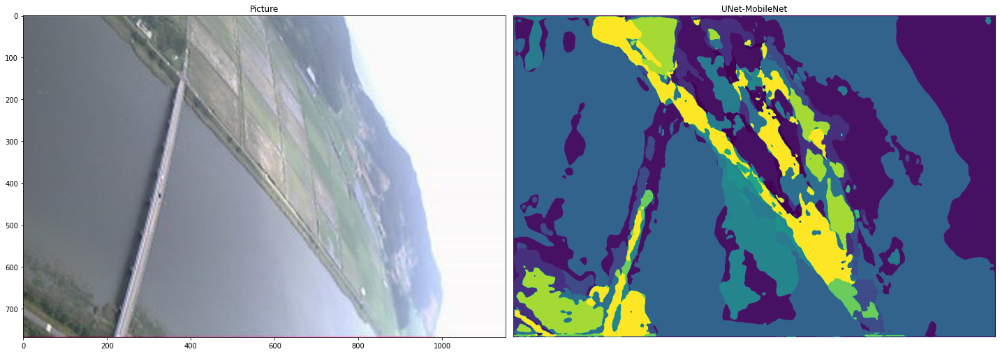

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '418'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


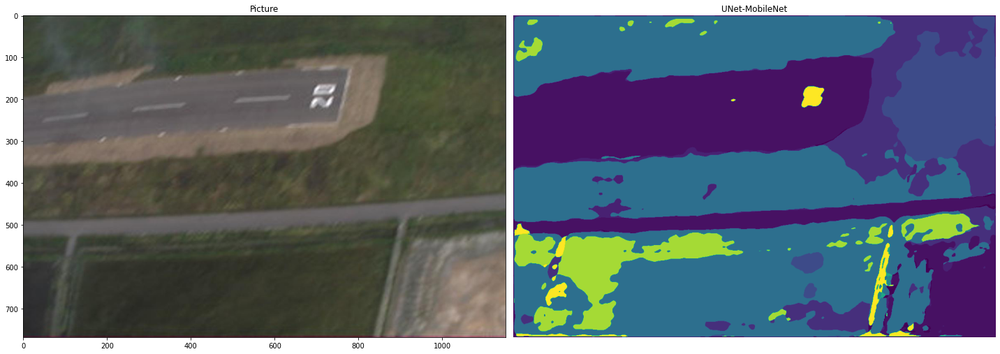

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '422'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


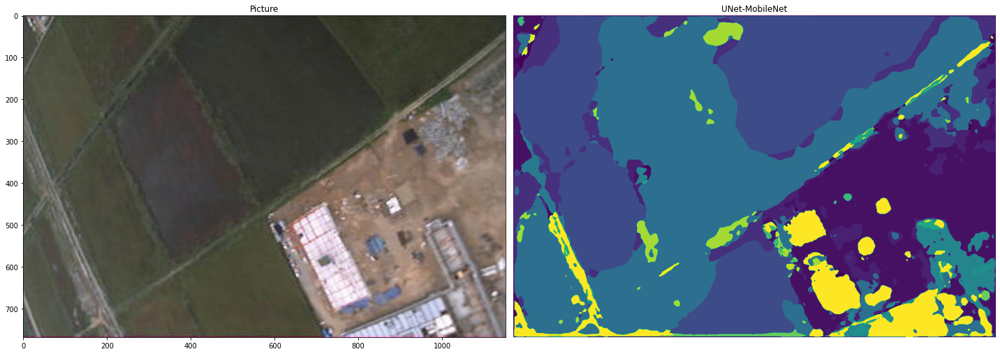

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '433'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


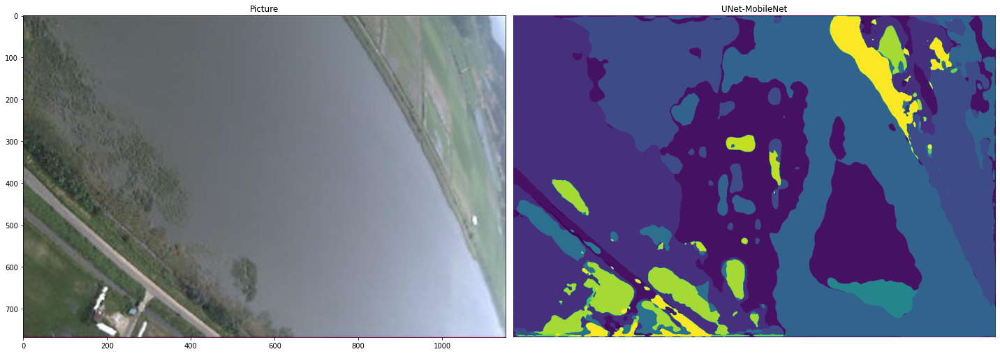

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '448'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


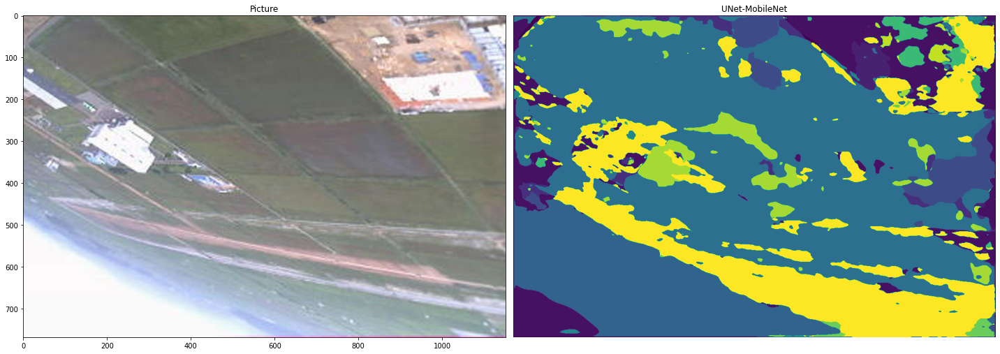

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '451'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


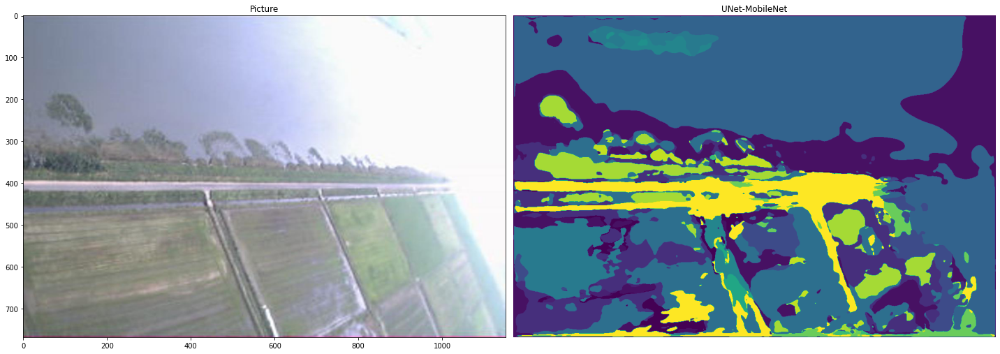

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '454'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


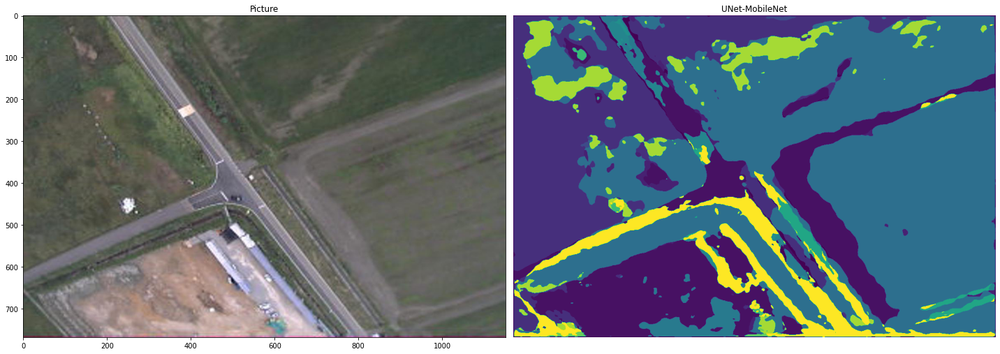

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '458'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


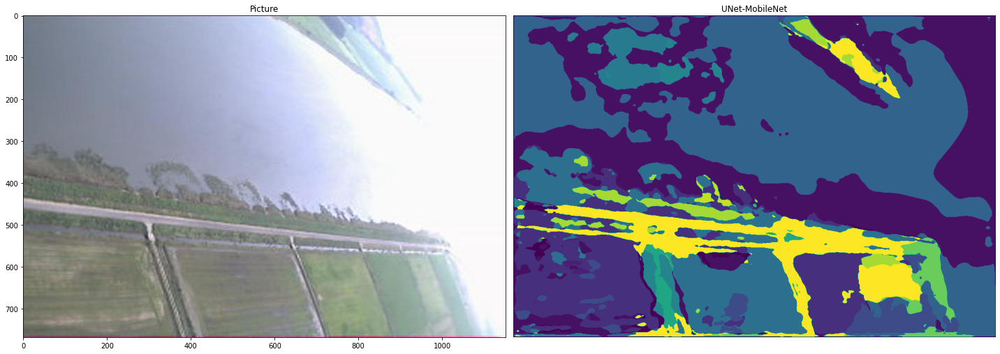

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '501'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


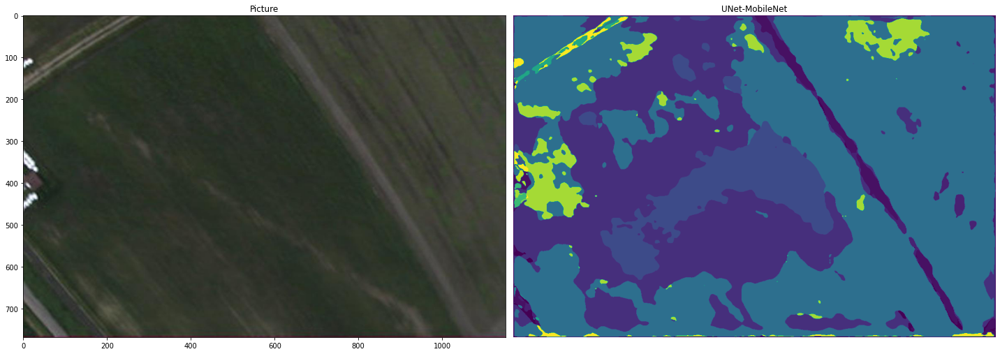

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '504'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


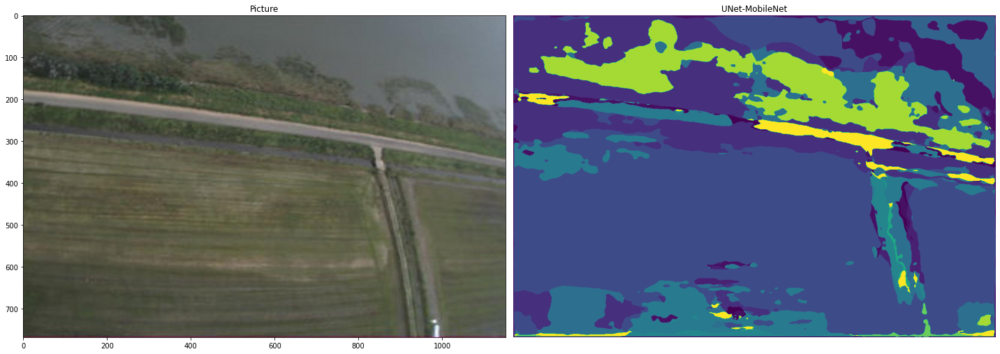

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '507'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


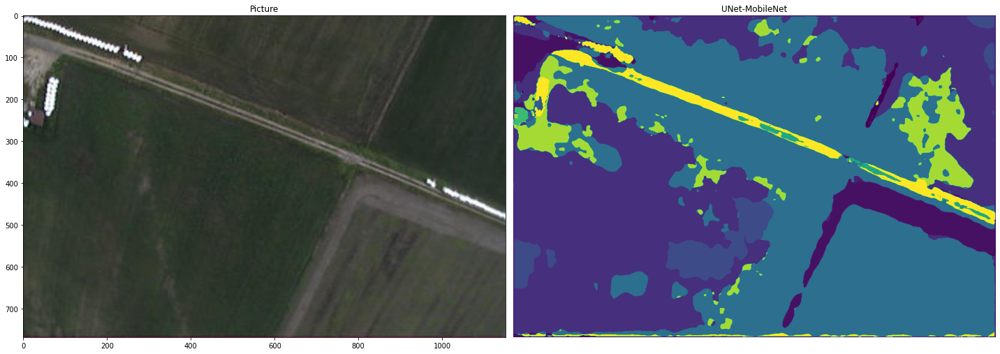

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '510'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


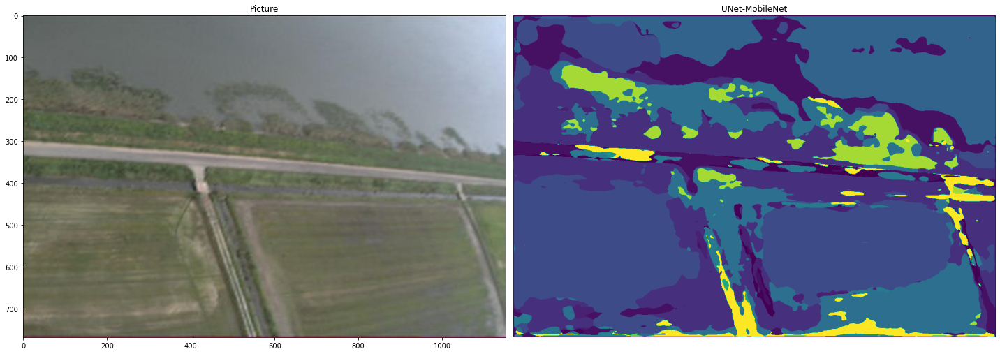

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '513'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


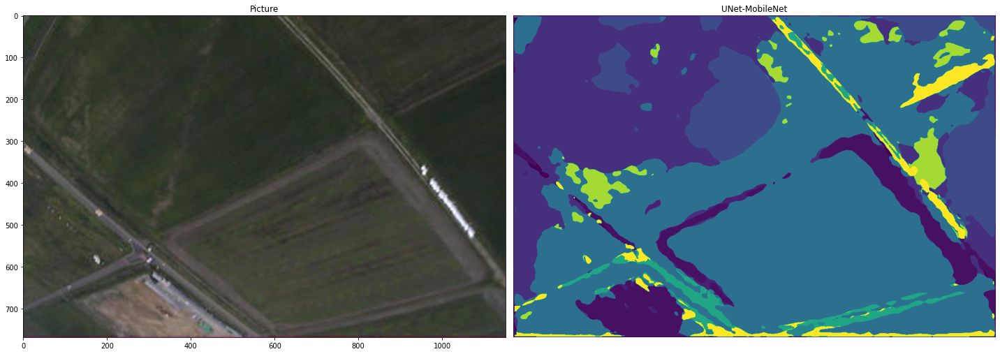

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '516'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


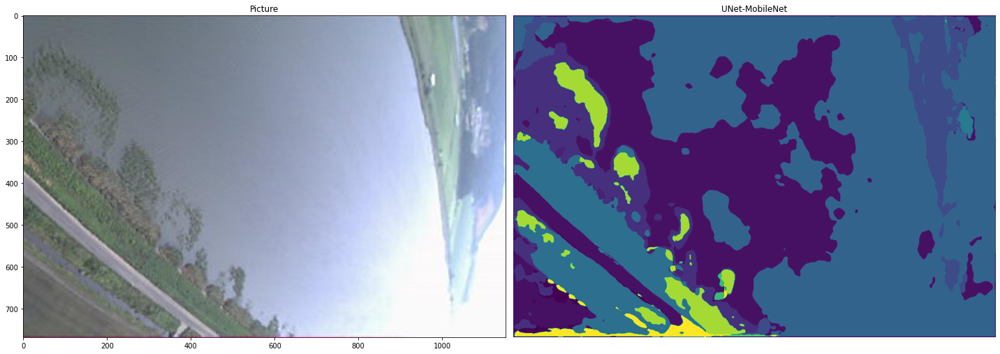

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '519'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


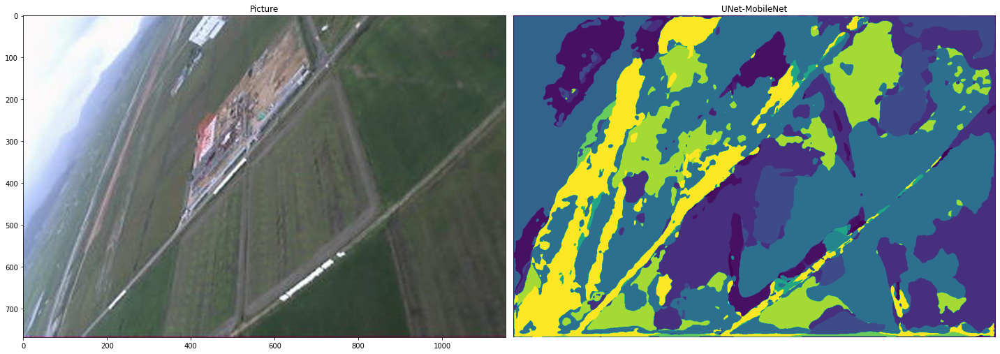

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '522'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


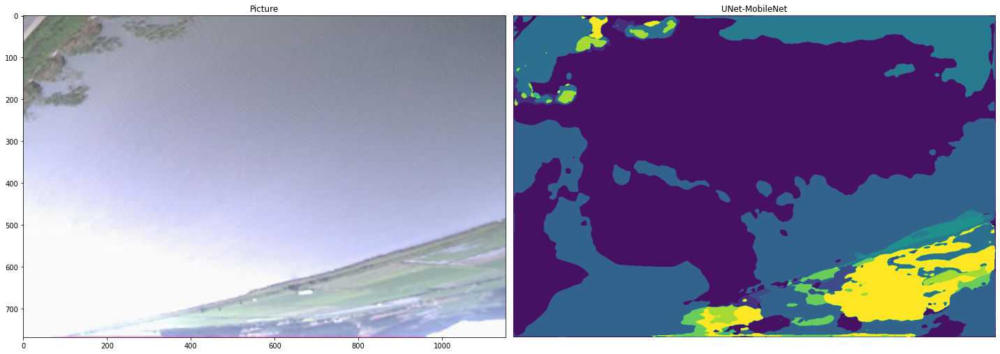

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '525'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


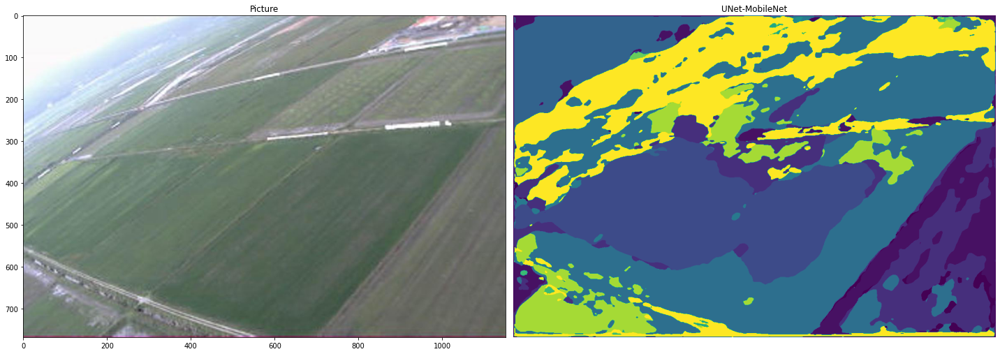

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '528'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


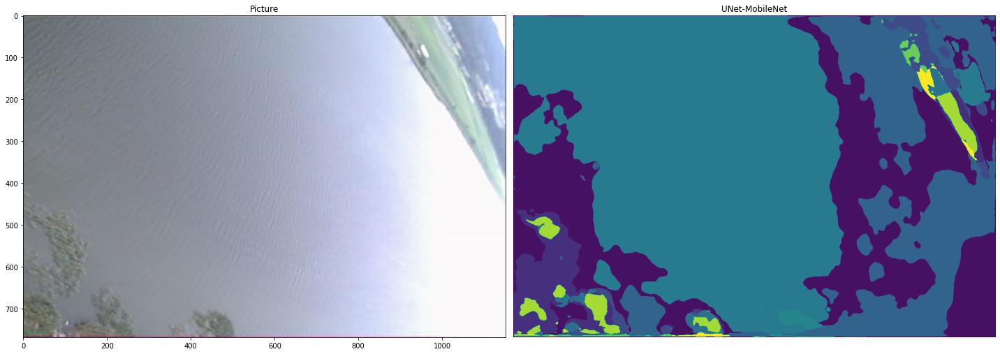

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '531'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


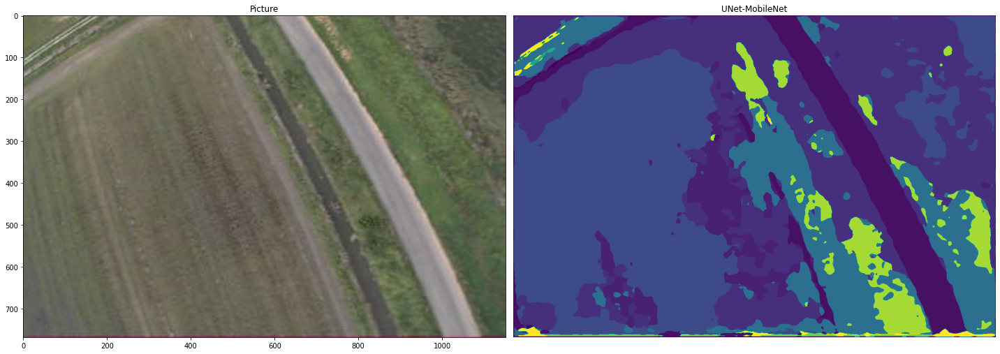

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '534'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


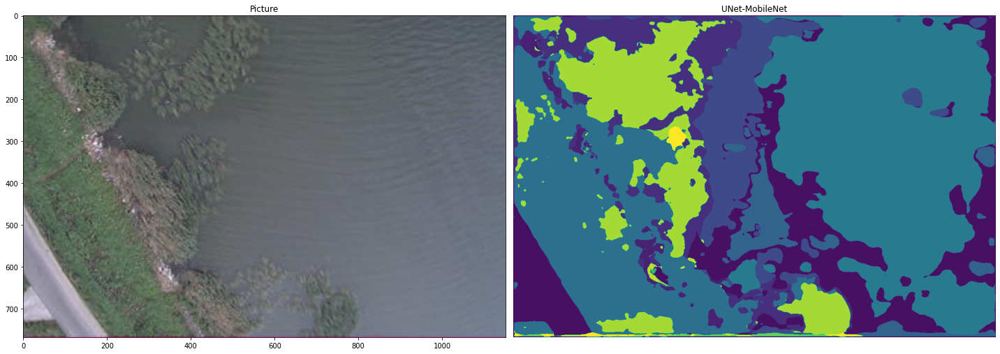

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '537'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


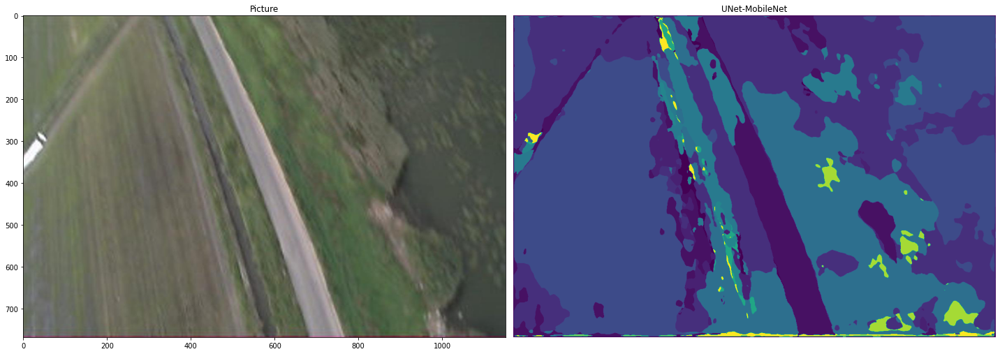

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '540'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


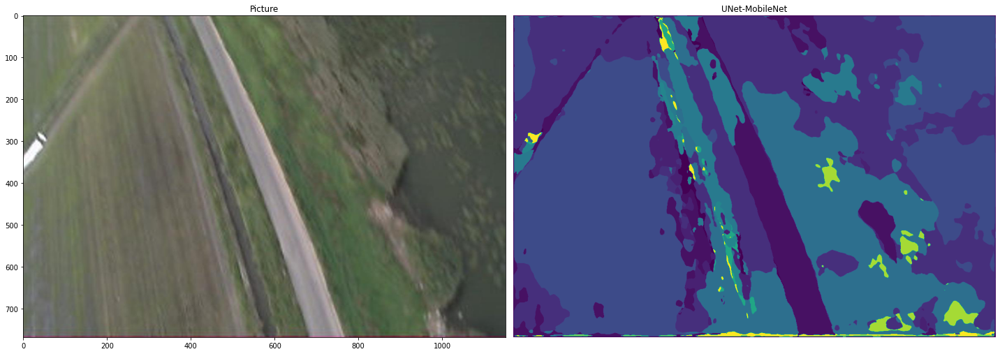

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '540'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


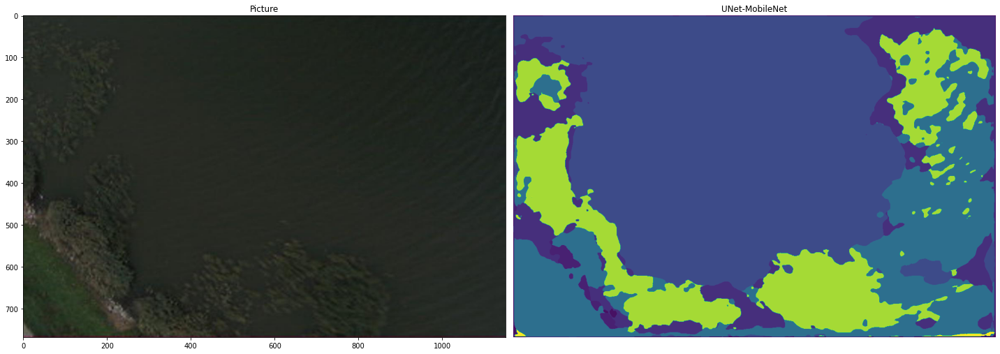

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '543'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


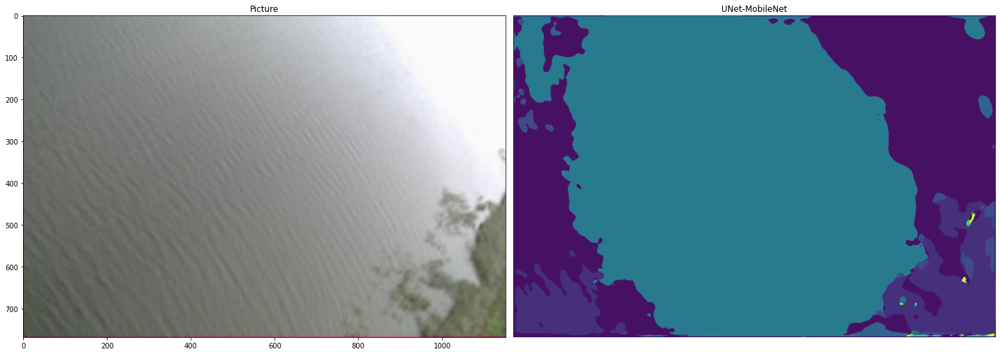

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '546'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


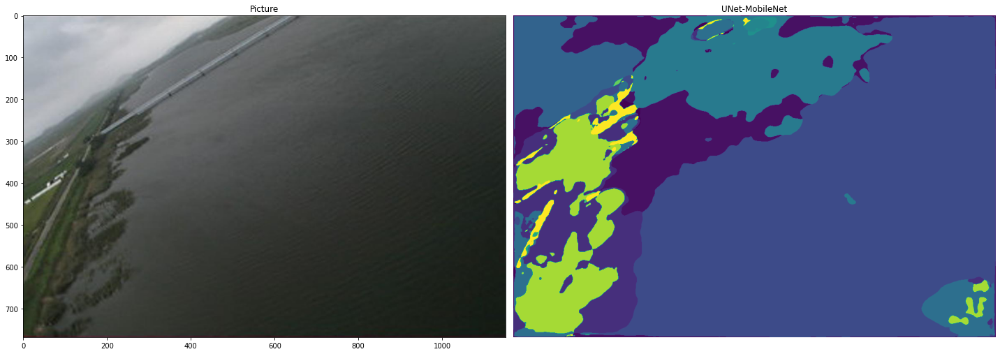

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '549'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


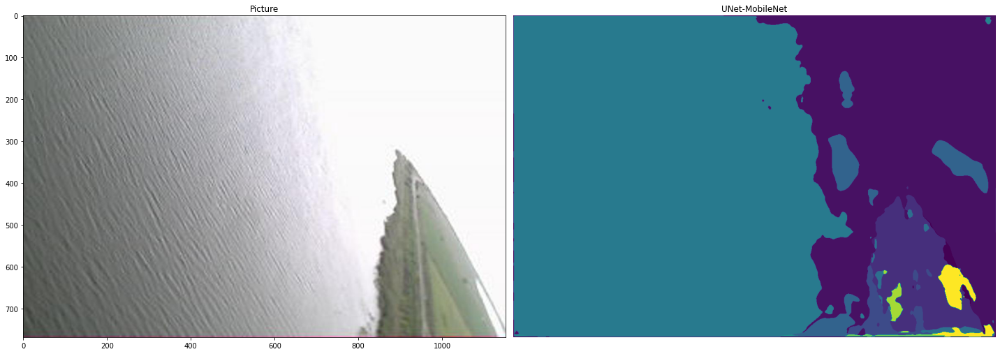

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '552'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


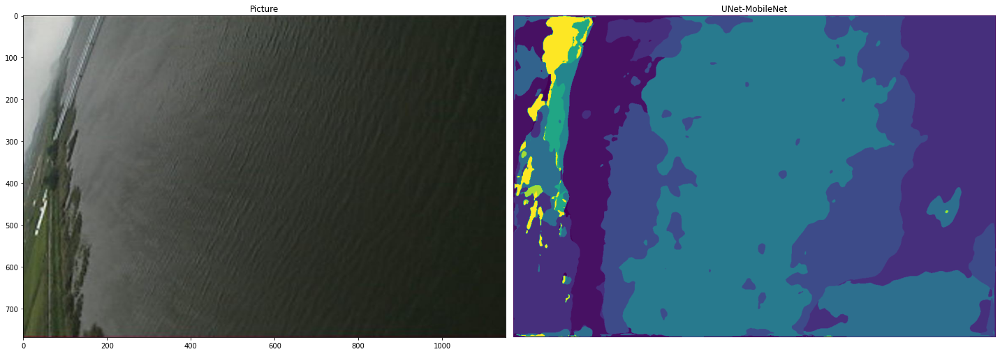

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '555'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


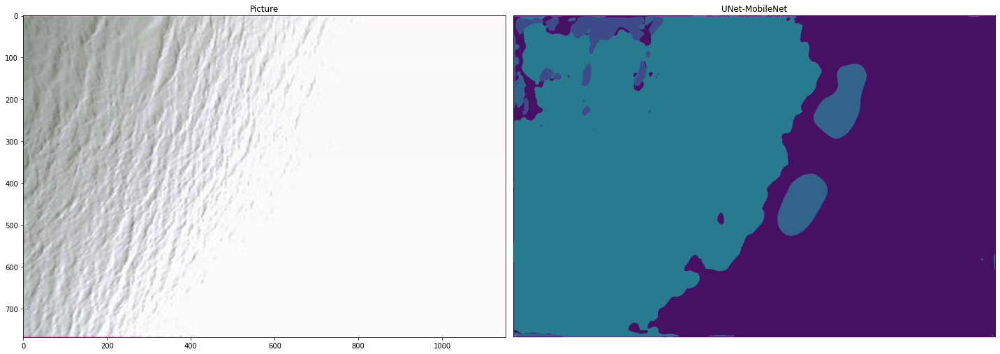

In [ ]:
img = Image.open('/content/' + 'Picture_200805_141' + '558'+'.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()


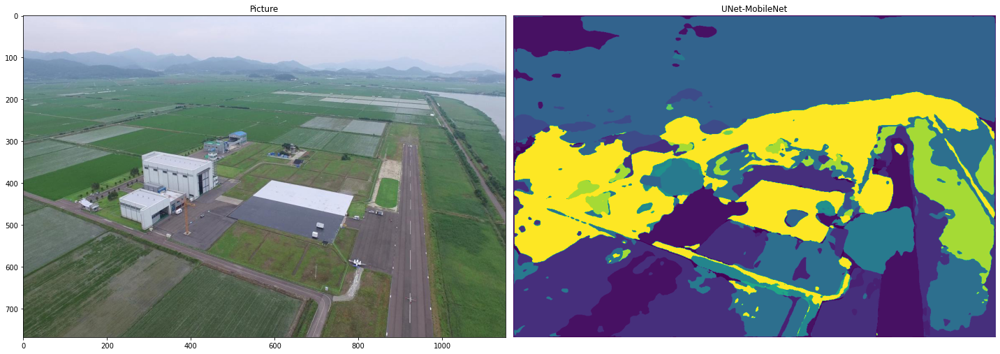

In [ ]:
img = Image.open('/content/DJI_0001_MOV_000330078.jpg')
resize_image = img.resize((1152,768))
resize_image.save('/content/cansat_image.jpg')
cansat_img = Image.open('/content/cansat_image.jpg')
pred_mask,score= predict_image_mask(model_Unet,Image.open('/content/cansat_image.jpg'), mask)

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(cansat_img)
ax1.set_title('Picture');

ax2.imshow(pred_mask)
ax2.set_title('UNet-MobileNet')
ax2.set_axis_off()
fig.tight_layout()
fig.show()
